## <center> **Excersice - Audio Processing** </center> <center> IF4021 - Multimedia Information Processing </center>

**Nama: Tawakkal Rabbani Muhammad**  
**NIM: 122140029**  
**Link Github:**

In [29]:
# --- Pustaka Utama untuk Analisis & Manipulasi Audio ---
import librosa                     # Pustaka utama untuk analisis dan manipulasi audio, seperti loading, pitch shifting, dan deteksi tempo.
import librosa.display             # Sub-modul dari librosa untuk visualisasi audio (waveform, spektogram).
import numpy as np                 # Pustaka fundamental untuk komputasi numerik, karena audio direpresentasikan sebagai array NumPy.
import soundfile as sf             # Digunakan untuk membaca dan menulis file audio dengan format yang lebih beragam.

# --- Pustaka untuk Filtering dan Pemrosesan Sinyal ---
from scipy.signal import butter, lfilter # Fungsi dari SciPy untuk mendesain dan menerapkan filter digital (low-pass, high-pass).

# --- Pustaka untuk Pengukuran Loudness (LUFS) ---
import pyloudnorm as pyln          # Pustaka khusus untuk mengukur dan menormalisasi loudness berdasarkan standar LUFS.

# --- Pustaka untuk Visualisasi Data ---
import matplotlib.pyplot as plt    # Pustaka utama untuk membuat plot dan grafik di Python.

# --- Pustaka untuk Menampilkan Audio di Jupyter Notebook ---
import IPython.display as ipd      # Berguna untuk memutar audio langsung di dalam sel output Jupyter Notebook.

# --- Pustaka Standar Python (jika diperlukan) ---
import os                          # Untuk berinteraksi dengan sistem operasi, seperti mengelola path file.

print("Semua pustaka berhasil diimpor!")

Semua pustaka berhasil diimpor!


#### **1. Soal 1: Rekaman dan Analisis Suara Multi-level**


In [30]:
# --- 1. Memuat File Audio ---
# Mendefinisikan path atau lokasi file audio yang akan dianalisis.
audio_path_soal1 = os.path.join(os.getcwd(), 'audio', 'audio-1.wav')

# Menggunakan librosa.load untuk memuat file audio.
# 'y' adalah data audio (amplitudo) dalam bentuk array NumPy.
# 'sr' adalah sample rate dari audio tersebut (jumlah sampel per detik).
y_soal1, sr_soal1 = librosa.load(audio_path_soal1)


# --- 2. Menghitung dan Menampilkan Informasi Audio ---
# Menghitung durasi audio dalam detik.
# Caranya adalah dengan membagi jumlah total sampel dengan sample rate.
duration = len(y_soal1) / sr_soal1

# Mengecek jumlah kanal audio (mono atau stereo).
# Jika array 'y' satu dimensi, berarti mono. Jika dua dimensi, berarti stereo.
channels = y_soal1.ndim

# Mendapatkan jumlah total sampel dari data audio.
total_samples = len(y_soal1)

# Mencetak semua informasi yang telah didapatkan ke layar.
print(f"Informasi Audio: {audio_path_soal1}")
print(f"Durasi          : {duration:.2f} detik")
print(f"Sample Rate     : {sr_soal1} Hz")
print(f"Jumlah Kanal    : {'Mono' if channels == 1 else 'Stereo'}")
print(f"Total Sampel    : {total_samples} sampel")

# Menampilkan dan memutar audio yang telah dimuat
display(ipd.Audio(data=y_soal1, rate=sr_soal1))

Informasi Audio: c:\Users\tawak\OneDrive\Documents\Takamuhammad\Kuliah\SMT7\Mulmet\Tugas\Multimedia-Exercise-Audio\audio\audio-1.wav
Durasi          : 25.43 detik
Sample Rate     : 22050 Hz
Jumlah Kanal    : Mono
Total Sampel    : 560717 sampel


##### **1.1 Visualisasi waveform dan spektogram dari rekaman suara**
<ul>
    <li> <b>Visualisasi Waveform</b>
</ul>

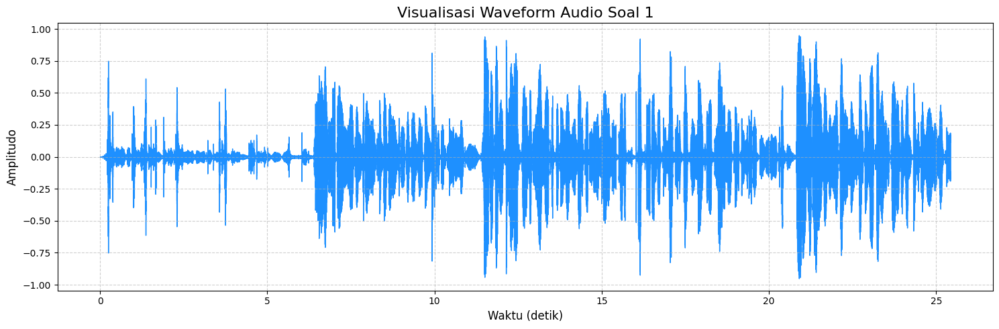

In [31]:
# --- 1. Pengaturan Tampilan Plot ---
# Membuat sebuah 'figure' (kanvas) dan 'axes' (area plot) untuk visualisasi.
# 'figsize' mengatur ukuran kanvas agar cukup lebar untuk menampilkan 25 detik.
fig, ax = plt.subplots(figsize=(15, 5))


# --- 2. Membuat Plot Waveform ---
# Menggunakan librosa.display.waveshow untuk memplot data audio (y) berdasarkan waktu.
# 'sr' diperlukan untuk menghitung sumbu waktu (x-axis) dalam satuan detik.
# 'ax' menentukan di mana plot ini akan digambar.
# 'color' mengatur warna garis waveform.
librosa.display.waveshow(y_soal1, sr=sr_soal1, ax=ax, color='dodgerblue')


# --- 3. Menambahkan Judul dan Label ---
# Memberikan judul yang jelas pada plot.
ax.set_title('Visualisasi Waveform Audio Soal 1', fontsize=16)

# Memberi label pada sumbu x (Waktu).
ax.set_xlabel('Waktu (detik)', fontsize=12)

# Memberi label pada sumbu y (Amplitudo).
ax.set_ylabel('Amplitudo', fontsize=12)

# Menambahkan grid untuk mempermudah pembacaan nilai pada plot.
ax.grid(True, linestyle='--', alpha=0.6)


# --- 4. Menampilkan Plot ---
# Memastikan semua elemen plot tersusun rapi tanpa tumpang tindih.
plt.tight_layout()

# Menampilkan hasil plot ke layar.
plt.show()

**Penjelasan singkat dari visualisasi waveform:**  
Dari visualisasi waveform yang diperoleh, bisa dilihat bahwa pola amplitudo tiap 5 detik akan terus berubah-berubah, di mana berubah semakin tinggi. Pola ini sesuai dengan kondisi suara yang direkam, yaitu di detik (0-5) adalah suara sangat pelan dan berbisik, kemudian 5 detik selanjutnya amplitudonya naik yang menandakan ini suara normal, 5 detik selanjutnya amplitudonya semakin naik yang menandakan suaranya keras, lalu naik lagi di 5 detik setelah yang menandakan suaranya cempreng dan terakhir naik lagi amplitudonya yang menandakan suaranya berteriak.




<ul>
    <li> <b>Visualisasi Spectogram</b>
</ul>

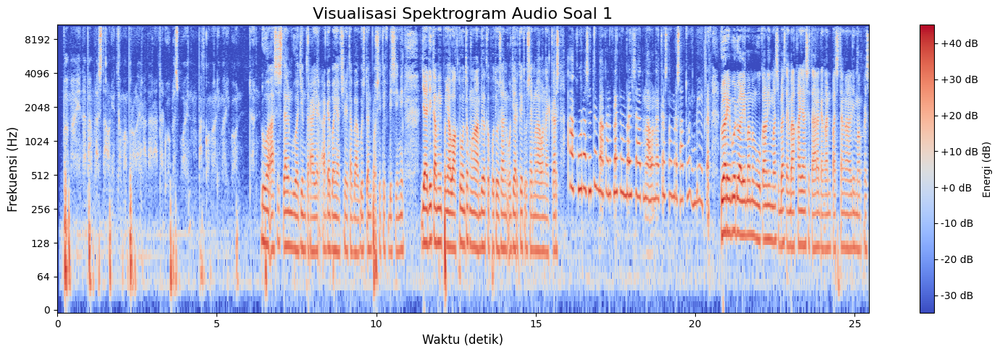

In [32]:
# --- 1. Menghitung Spektogram ---
# Menghitung Short-Time Fourier Transform (STFT) dari sinyal audio.
# STFT memecah sinyal menjadi frame-frame pendek dan menghitung spektrum frekuensinya.
stft_result = librosa.stft(y_soal1)

# Mengonversi amplitudo dari STFT ke skala desibel (dB).
# Skala dB lebih sesuai dengan persepsi pendengaran manusia.
db_result = librosa.amplitude_to_db(abs(stft_result))


# --- 2. Pengaturan Tampilan Plot ---
# Membuat 'figure' dan 'axes' untuk plot, dengan ukuran yang sesuai.
fig, ax = plt.subplots(figsize=(15, 5))


# --- 3. Membuat Plot Spektogram ---
# Menggunakan librosa.display.specshow untuk memvisualisasikan data spektogram.
# Sumbu x adalah waktu, sumbu y adalah frekuensi, dan warna menunjukkan energi/amplitudo (dB).
img = librosa.display.specshow(db_result, sr=sr_soal1, x_axis='time', y_axis='log', ax=ax)

# Menambahkan 'colorbar' untuk menunjukkan pemetaan warna ke nilai desibel.
fig.colorbar(img, format='%+2.0f dB', label='Energi (dB)')


# --- 4. Menambahkan Judul dan Label ---
# Memberikan judul yang jelas pada plot.
ax.set_title('Visualisasi Spektrogram Audio Soal 1', fontsize=16)

# Memberi label pada sumbu x (sudah diatur oleh specshow).
ax.set_xlabel('Waktu (detik)', fontsize=12)

# Memberi label pada sumbu y. 'Log' digunakan agar frekuensi rendah lebih terlihat.
ax.set_ylabel('Frekuensi (Hz)', fontsize=12)


# --- 5. Menampilkan Plot ---
# Memastikan semua elemen plot tersusun rapi.
plt.tight_layout()

# Menampilkan hasil plot ke layar.
plt.show()

**Penjelasan singkat dari visualisasi spectogram:**  
Dari visualisasi spectogram yang diperoleh, bisa dilihat bahwa pola frekuensi tiap 5 detik akan terus berubah-berubah, di mana berubah semakin tinggi. Di detik 15-20 terlihat bahwa frekuensi yang dihasilkan tinggi yang menandakan suara yang dibuat memiliki frekuensi tinggi dan ini sesuai dengan suara yang dibuat yaitu suara suara cempreng

#### **1.2 Lakukan resampling pada ﬁle audio kemudian bandingkan kualitas dan durasinya**

In [33]:

# --- 1. Menentukan Sample Rate Baru ---
# Sample rate asli = 22050 Hz
sr_original = sr_soal1

# Menentukan sample rate yang lebih rendah untuk downsampling (kualitas telepon).
sr_downsampled = 8000

# --- 2. Melakukan Resampling ---
# Downsampling: Mengubah audio ke sample rate yang lebih rendah.
# Kualitas akan menurun, detail frekuensi tinggi akan hilang.
y_downsampled = librosa.resample(y=y_soal1, orig_sr=sr_original, target_sr=sr_downsampled)
# Melihat durasi audio setelah downsampling
duration_downsampled = len(y_downsampled) / sr_downsampled


# --- 3. Membandingkan Hasil Audio ---
print("--- Perbandingan Hasil Resampling ---")
print(f"Sample Rate Asli       : {sr_original} Hz")
print(f"Total Sampel Asli      : {len(y_soal1)} sampel")
print(f"Durasi Audio Asli      : {duration:.2f} detik")

# Tampilkan audio hasil downsampling
print(f"\nSample Rate Downsampled  : {sr_downsampled} Hz")
print(f"Total Sampel Baru        : {len(y_downsampled)} sampel")
print(f"Durasi Audio Downsampled : {duration_downsampled:.2f} detik")

print("\n--- Audio Asli ---")
display(ipd.Audio(data=y_soal1, rate=sr_original))
print("\n--- Audio Downsampled (8000 Hz) ---")
display(ipd.Audio(data=y_downsampled, rate=sr_downsampled))

--- Perbandingan Hasil Resampling ---
Sample Rate Asli       : 22050 Hz
Total Sampel Asli      : 560717 sampel
Durasi Audio Asli      : 25.43 detik

Sample Rate Downsampled  : 8000 Hz
Total Sampel Baru        : 203435 sampel
Durasi Audio Downsampled : 25.43 detik

--- Audio Asli ---



--- Audio Downsampled (8000 Hz) ---


**Perbandingan hasil resampling (downsampling) dengan sample asli**:  
Setelah melakukan proses resampling, dapat dilihat bahwa total durasi audio tidak berubah sama sekali, namun yang berubah adalah sample rate nya dari 22050 Hz menjadi 8000 Hz efeknya adalah kualitas audio yang dihasilkan menjadi kurang jelas.

---

#### **2. Soal 2: Noise Reduction dengan Filtering**

In [34]:
# --- 1. Memuat File Audio ---
# Mendefinisikan path atau lokasi file audio yang akan dianalisis.
audio_path_soal2 = os.path.join(os.getcwd(), 'audio', 'audio-2.wav')

# Menggunakan librosa.load untuk memuat file audio.
# 'y' adalah data audio (amplitudo) dalam bentuk array NumPy.
# 'sr' adalah sample rate dari audio tersebut (jumlah sampel per detik).
y_noisy, sr_noisy = librosa.load(audio_path_soal2)


# --- 2. Menghitung dan Menampilkan Informasi Audio ---
# Menghitung durasi audio dalam detik.
# Caranya adalah dengan membagi jumlah total sampel dengan sample rate.
duration = len(y_noisy) / sr_noisy

# Mengecek jumlah kanal audio (mono atau stereo).
# Jika array 'y' satu dimensi, berarti mono. Jika dua dimensi, berarti stereo.
channels = y_noisy.ndim

# Mendapatkan jumlah total sampel dari data audio.
total_samples = len(y_noisy)

# Mencetak semua informasi yang telah didapatkan ke layar.
print(f"Informasi Audio: {audio_path_soal2}")
print(f"Durasi          : {duration:.2f} detik")
print(f"Sample Rate     : {sr_noisy} Hz")
print(f"Jumlah Kanal    : {'Mono' if channels == 1 else 'Stereo'}")
print(f"Total Sampel    : {total_samples} sampel")
# Menampilkan dan memutar audio 
print("--- Memutar Audio---")
display(ipd.Audio(data=y_noisy, rate=sr_noisy))


Informasi Audio: c:\Users\tawak\OneDrive\Documents\Takamuhammad\Kuliah\SMT7\Mulmet\Tugas\Multimedia-Exercise-Audio\audio\audio-2.wav
Durasi          : 12.35 detik
Sample Rate     : 22050 Hz
Jumlah Kanal    : Mono
Total Sampel    : 272362 sampel
--- Memutar Audio---


##### **2.1 Gunakan filter equalisasi untuk menghilangkan noise**

--- Spectrogram Audio Asli (dengan Noise) ---


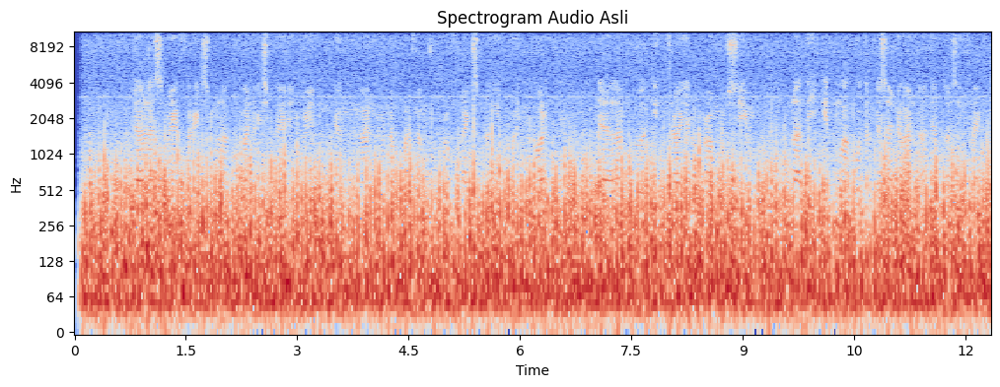

In [35]:
# Menampilkan spektogram audio asli sebagai pembanding
print("--- Spectrogram Audio Asli (dengan Noise) ---")
stft_original = librosa.stft(y_noisy)
db_original = librosa.amplitude_to_db(abs(stft_original))
fig, ax = plt.subplots(figsize=(12, 4))
librosa.display.specshow(db_original, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax)
ax.set_title('Spectrogram Audio Asli')
plt.show()

<ul>
    <li> <b>Menggunakan Filter Low-Pass</b>
</ul>

--- Spektogram Setelah Low-Pass Filter (2000 Hz) ---


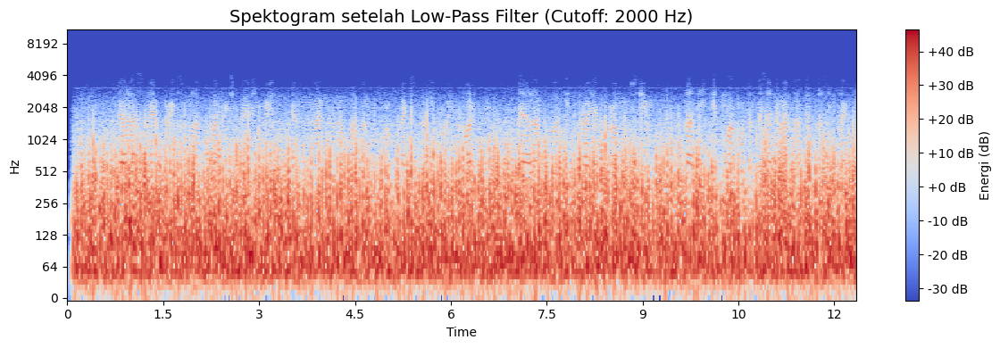

--- Memutar Audio Hasil Low-Pass ---


In [36]:
# --- Menerapkan Low-Pass Filter ---

# Menentukan frekuensi cutoff. Semua frekuensi DI ATAS ini akan diredam.
cutoff_low = 2000  # Hz

# Mendesain filter Butterworth orde 5
b, a = butter(5, cutoff_low, btype='lowpass', fs=sr_noisy)

# Menerapkan filter ke sinyal audio yang bising
y_lowpassed = lfilter(b, a, y_noisy)

# --- Visualisasi Spectrogram Hasil Low-Pass ---
print(f"--- Spektogram Setelah Low-Pass Filter ({cutoff_low} Hz) ---")
stft_low = librosa.stft(y_lowpassed)
db_low = librosa.amplitude_to_db(abs(stft_low))

fig, ax = plt.subplots(figsize=(12, 4))
img = librosa.display.specshow(db_low, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB', label='Energi (dB)')
ax.set_title(f'Spektogram setelah Low-Pass Filter (Cutoff: {cutoff_low} Hz)', fontsize=14)
plt.tight_layout()
plt.show()

# Menampilkan hasil Low-Pass Filter
print("--- Memutar Audio Hasil Low-Pass ---")
display(ipd.Audio(data=y_lowpassed, rate=sr_noisy))

<ul>
    <li> <b>Menggunakan Filter High-Pass</b>
</ul>

--- Spektogram Setelah High-Pass Filter (500 Hz) ---


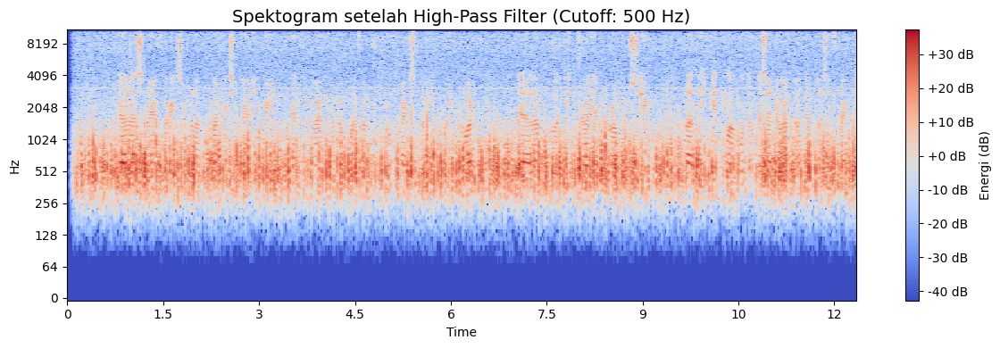

--- Memutar Audio Hasil High-Pass ---


In [37]:
# --- Menerapkan High-Pass Filter ---

# Menentukan frekuensi cutoff. Semua frekuensi DI BAWAH ini akan diredam.
cutoff_high = 500  # Hz

# Mendesain filter Butterworth orde 5
b, a = butter(5, cutoff_high, btype='highpass', fs=sr_noisy)

# Menerapkan filter ke sinyal audio yang bising
y_highpassed = lfilter(b, a, y_noisy)

# --- Visualisasi Spectrogram Hasil High-Pass ---
print(f"--- Spektogram Setelah High-Pass Filter ({cutoff_high} Hz) ---")
stft_high = librosa.stft(y_highpassed)
db_high = librosa.amplitude_to_db(abs(stft_high))

fig, ax = plt.subplots(figsize=(12, 4))
img = librosa.display.specshow(db_high, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB', label='Energi (dB)')
ax.set_title(f'Spektogram setelah High-Pass Filter (Cutoff: {cutoff_high} Hz)', fontsize=14)
plt.tight_layout()
plt.show()

print("--- Memutar Audio Hasil High-Pass ---")
display(ipd.Audio(data=y_highpassed, rate=sr_noisy))

<ul>
    <li> <b>Menggunakan Filter Band-Pass</b>
</ul>

--- Spektogram Setelah Band-Pass Filter (300-3400 Hz) ---


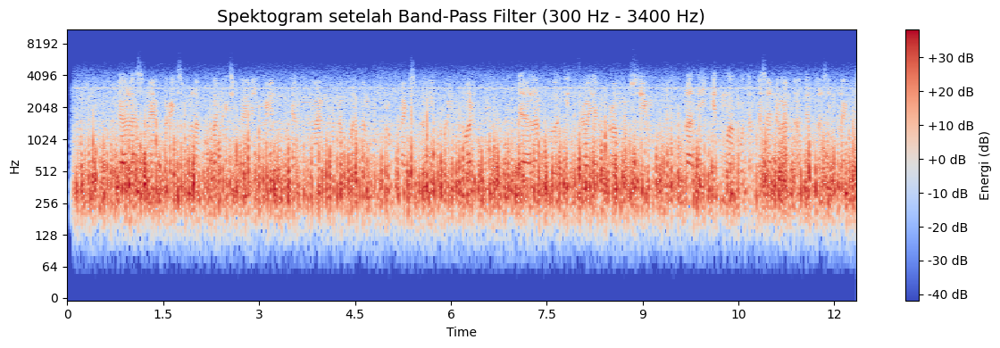

--- Memutar Audio Hasil Band-Pass ---


In [38]:
# --- Menerapkan Band-Pass Filter ---

# Menentukan rentang frekuensi yang ingin diloloskan.
# Frekuensi di luar rentang [300, 3400] akan diredam.
cutoff_band = [300, 3400]  # Hz

# Mendesain filter Butterworth orde 5
b, a = butter(5, cutoff_band, btype='band', fs=sr_noisy)

# Menerapkan filter ke sinyal audio yang bising
y_bandpassed = lfilter(b, a, y_noisy)

# --- Visualisasi Spectrogram Hasil Band-Pass ---
print(f"--- Spektogram Setelah Band-Pass Filter ({cutoff_band[0]}-{cutoff_band[1]} Hz) ---")
stft_band = librosa.stft(y_bandpassed)
db_band = librosa.amplitude_to_db(abs(stft_band))

fig, ax = plt.subplots(figsize=(12, 4))
img = librosa.display.specshow(db_band, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB', label='Energi (dB)')
ax.set_title(f'Spektogram setelah Band-Pass Filter ({cutoff_band[0]} Hz - {cutoff_band[1]} Hz)', fontsize=14)
plt.tight_layout()
plt.show()

print("--- Memutar Audio Hasil Band-Pass ---")
display(ipd.Audio(data=y_bandpassed, rate=sr_noisy))

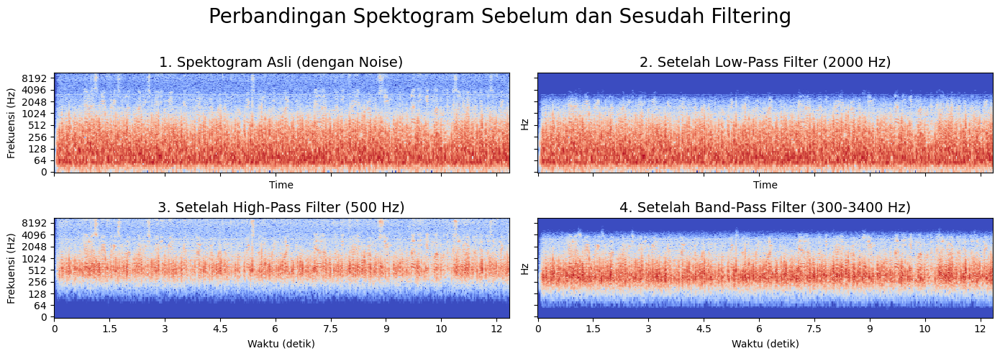

In [39]:
# y_noisy, sr_noisy, y_lowpassed, y_highpassed, y_bandpassed

# --- 1. Membuat Grid Plot 2x2 ---
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(14, 5), sharex=True, sharey=True)

# --- 2. Menghitung & Plot Spektogram untuk Masing-masing Audio ---

# Plot 1: Audio Asli (Pojok Kiri Atas)
stft_original = librosa.stft(y_noisy)
db_original = librosa.amplitude_to_db(abs(stft_original))
librosa.display.specshow(db_original, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax[0, 0])
ax[0, 0].set_title('1. Spektogram Asli (dengan Noise)', fontsize=14)
ax[0, 0].set_ylabel('Frekuensi (Hz)')

# Plot 2: Hasil Low-Pass Filter (Pojok Kanan Atas)
stft_low = librosa.stft(y_lowpassed)
db_low = librosa.amplitude_to_db(abs(stft_low))
librosa.display.specshow(db_low, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax[0, 1])
ax[0, 1].set_title(f'2. Setelah Low-Pass Filter ({cutoff_low} Hz)', fontsize=14)

# Plot 3: Hasil High-Pass Filter (Pojok Kiri Bawah)
stft_high = librosa.stft(y_highpassed)
db_high = librosa.amplitude_to_db(abs(stft_high))
librosa.display.specshow(db_high, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax[1, 0])
ax[1, 0].set_title(f'3. Setelah High-Pass Filter ({cutoff_high} Hz)', fontsize=14)
ax[1, 0].set_xlabel('Waktu (detik)')
ax[1, 0].set_ylabel('Frekuensi (Hz)')

# Plot 4: Hasil Band-Pass Filter (Pojok Kanan Bawah)
stft_band = librosa.stft(y_bandpassed)
db_band = librosa.amplitude_to_db(abs(stft_band))
img = librosa.display.specshow(db_band, sr=sr_noisy, x_axis='time', y_axis='log', ax=ax[1, 1])
ax[1, 1].set_title(f'4. Setelah Band-Pass Filter ({cutoff_band[0]}-{cutoff_band[1]} Hz)', fontsize=14)
ax[1, 1].set_xlabel('Waktu (detik)')

# --- 3. Menambahkan Detail Akhir dan Menampilkan ---
# Memberikan judul utama untuk keseluruhan gambar
fig.suptitle('Perbandingan Spektogram Sebelum dan Sesudah Filtering', fontsize=20)

# Merapikan layout
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Menampilkan plot
plt.show()

**Perbandingan:**
- Low-Pass: Dapat dilihat frekuensi yang berada di atas 2000 Hz menghilang.
- High-Pass: Dapat dilihat frekuensi yang berada di bawah 500 Hz menghilang.
- Band-Pass: Dapat dilihat frekuensi yang ada berada di antara 300-3400 Hz

**Penjelasan:**
- Noise yang muncul pada rekaman adalah suara kipas yang cukup kencang. Asumsi saya noise dari kipas tersebut berada di frekuensi rendah kisaran di bawah 600 Hz.
- Filter yang paling efektif dalam mengurangi noise tersebut menurut saya adalah Filter High-Pass, di mana suara dari noise mulai berkurang namun tidak menghilangkan suara saya (manusia) sehingga masih bisa didengar.
- Nilai cutoff yang memberikan hasil terbaik menurut saya adalah di 500 Hz.
- Kualitas suara yang dihasilkan setelah melakukan High-Pass, noise nya mulai berkurang walaupun masih ada sedikit suara noicenya akan tetapi suara saya menjadi lebih jelas.

---

#### **3. Soal 3: Pitch Shifting dan Audio Manipulation**  
Di sini saya menggunakan **audio-1.wav**

In [40]:
# --- 1. Memuat File Audio ---
# Mendefinisikan path atau lokasi file audio yang akan dianalisis.
audio_path_soal1 = os.path.join(os.getcwd(), 'audio', 'audio-1.wav')

# Menggunakan librosa.load untuk memuat file audio.
# 'y' adalah data audio (amplitudo) dalam bentuk array NumPy.
# 'sr' adalah sample rate dari audio tersebut (jumlah sampel per detik).
y_soal1, sr_soal1 = librosa.load(audio_path_soal1)


# --- 2. Menghitung dan Menampilkan Informasi Audio ---
# Menghitung durasi audio dalam detik.
# Caranya adalah dengan membagi jumlah total sampel dengan sample rate.
duration = len(y_soal1) / sr_soal1

# Mengecek jumlah kanal audio (mono atau stereo).
# Jika array 'y' satu dimensi, berarti mono. Jika dua dimensi, berarti stereo.
channels = y_soal1.ndim

# Mendapatkan jumlah total sampel dari data audio.
total_samples = len(y_soal1)

# Mencetak semua informasi yang telah didapatkan ke layar.
print(f"Informasi Audio: {audio_path_soal1}")
print(f"Durasi          : {duration:.2f} detik")
print(f"Sample Rate     : {sr_soal1} Hz")
print(f"Jumlah Kanal    : {'Mono' if channels == 1 else 'Stereo'}")
print(f"Total Sampel    : {total_samples} sampel")

Informasi Audio: c:\Users\tawak\OneDrive\Documents\Takamuhammad\Kuliah\SMT7\Mulmet\Tugas\Multimedia-Exercise-Audio\audio\audio-1.wav
Durasi          : 25.43 detik
Sample Rate     : 22050 Hz
Jumlah Kanal    : Mono
Total Sampel    : 560717 sampel


#### **3.1 Melakukan Pitch Shifting**

In [41]:
# --- Melakukan Pitch Shift +7 Semitone ---
# 'n_steps' adalah jumlah setengah nada (semitone) yang ingin dinaikkan.
# Nilai positif menaikkan pitch, nilai negatif menurunkannya.
n_steps_7 = 7
y_chipmunk_7 = librosa.effects.pitch_shift(y=y_soal1, sr=sr_soal1, n_steps=n_steps_7)

# --- Melakukan Pitch Shift +12 Semitone ---
# Menaikkan 12 semitone sama dengan menaikkan nada sebanyak satu oktaf penuh.
n_steps_12 = 12
y_chipmunk_12 = librosa.effects.pitch_shift(y=y_soal1, sr=sr_soal1, n_steps=n_steps_12)

# Menampilkan dan memutar hasil pitch shifting +7 dan +12
print("--- Hasil Pitch Shift +7 Semitone ---")
display(ipd.Audio(data=y_chipmunk_7, rate=sr_soal1))

print("\n--- Hasil Pitch Shift +12 Semitone ---")
display(ipd.Audio(data=y_chipmunk_12, rate=sr_soal1))

--- Hasil Pitch Shift +7 Semitone ---



--- Hasil Pitch Shift +12 Semitone ---


#### **3.2 Menampilkan visualisasi**

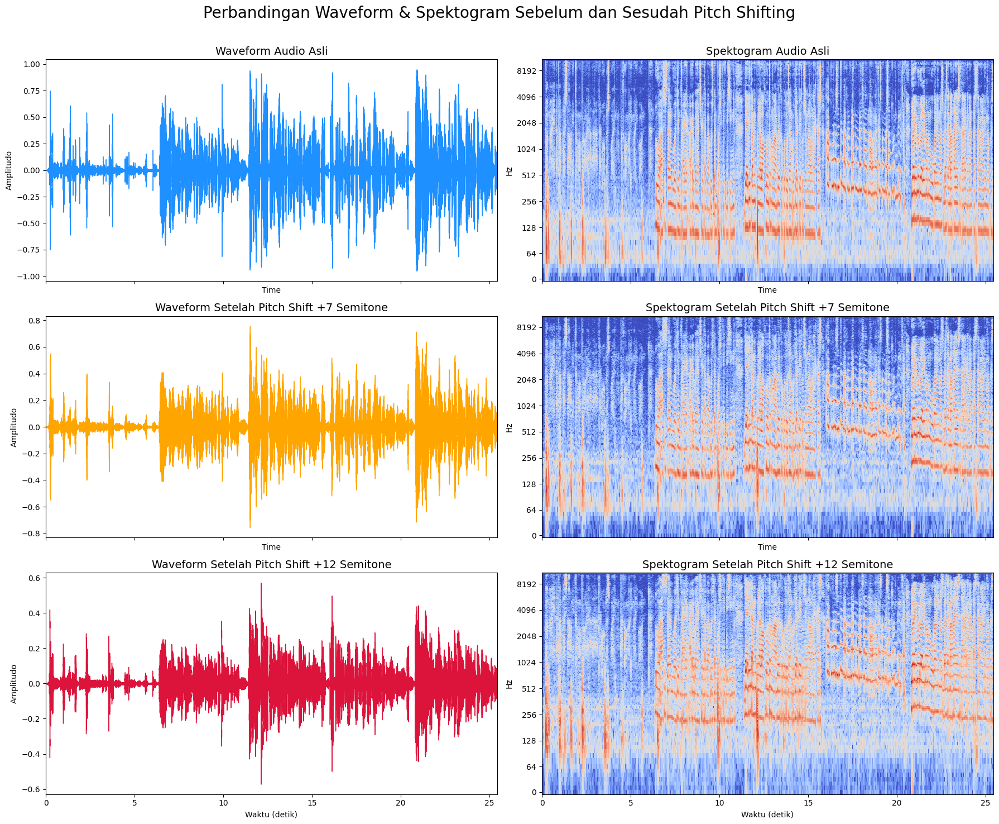

In [42]:
# --- 1. Membuat Grid Plot 3x2 ---
# Membuat grid dengan 3 baris dan 2 kolom untuk 6 plot.
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(18, 15), sharex=True)

# --- Baris 1: Audio Asli ---
# Waveform Asli
librosa.display.waveshow(y_soal1, sr=sr_soal1, ax=ax[0, 0], color='dodgerblue')
ax[0, 0].set_title('Waveform Audio Asli', fontsize=14)
ax[0, 0].set_ylabel('Amplitudo')

# Spektogram Asli
stft_orig = librosa.stft(y_soal1)
db_orig = librosa.amplitude_to_db(abs(stft_orig))
librosa.display.specshow(db_orig, sr=sr_soal1, x_axis='time', y_axis='log', ax=ax[0, 1])
ax[0, 1].set_title('Spektogram Audio Asli', fontsize=14)


# --- Baris 2: Pitch Shift +7 Semitone ---
# Waveform +7
librosa.display.waveshow(y_chipmunk_7, sr=sr_soal1, ax=ax[1, 0], color='orange')
ax[1, 0].set_title('Waveform Setelah Pitch Shift +7 Semitone', fontsize=14)
ax[1, 0].set_ylabel('Amplitudo')

# Spektogram +7
stft_7 = librosa.stft(y_chipmunk_7)
db_7 = librosa.amplitude_to_db(abs(stft_7))
librosa.display.specshow(db_7, sr=sr_soal1, x_axis='time', y_axis='log', ax=ax[1, 1])
ax[1, 1].set_title('Spektogram Setelah Pitch Shift +7 Semitone', fontsize=14)


# --- Baris 3: Pitch Shift +12 Semitone ---
# Waveform +12
librosa.display.waveshow(y_chipmunk_12, sr=sr_soal1, ax=ax[2, 0], color='crimson')
ax[2, 0].set_title('Waveform Setelah Pitch Shift +12 Semitone', fontsize=14)
ax[2, 0].set_xlabel('Waktu (detik)')
ax[2, 0].set_ylabel('Amplitudo')

# Spektogram +12
stft_12 = librosa.stft(y_chipmunk_12)
db_12 = librosa.amplitude_to_db(abs(stft_12))
img = librosa.display.specshow(db_12, sr=sr_soal1, x_axis='time', y_axis='log', ax=ax[2, 1])
ax[2, 1].set_title('Spektogram Setelah Pitch Shift +12 Semitone', fontsize=14)
ax[2, 1].set_xlabel('Waktu (detik)')


# --- 3. Menambahkan Detail Akhir dan Menampilkan ---
# Memberikan judul utama
fig.suptitle('Perbandingan Waveform & Spektogram Sebelum dan Sesudah Pitch Shifting', fontsize=20)

# Merapikan layout
plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.show()

#### **3.3 Penjelasan:**  
1. Parameter yang digunakan: 
    - y_soal1 => adalah parameter yang menyimpan file audio 1 saya.
    - sr_soal1 => adalah parameter sampe rate dari audio 1 saya.
    - n_steps_7 & n_steps_12 => adalah parameter nilai pitch tinggi yang akan digunakan.

2. Perbedaan dalam representasi visual:
    - Waveform => Hasil Waveform setelah dilakukannya Pitching yaitu amplitudo yang dihasilkan lebih rendah dari aslinya.
    - Spektogram => Hasil Spektogram setelah dilakukannya Pitching yaitu frekuensi suara yang dihasilkan menjadi naik dari aslinya. 
    - Perubah pitch sangat memengarahui kualitas dan kejelasan suara, yaitu kualitas yang dihasilkan menjadi kurang baik, karena frekuensi suaranya sangat tinggi sehingga kejelasan suaranya sulit didengar.


#### **3.4 Menggabungkan Dua Audio**

In [43]:
# Import pustaka yang dibutuhkan
from pydub import AudioSegment
import numpy as np
import os

# --- 1. Konversi Array NumPy (Librosa) ke AudioSegment (Pydub) ---

# Pydub bekerja dengan integer, sedangkan array librosa adalah float (-1.0 hingga 1.0).
# Kita perlu mengubah skala nilai float ke integer 16-bit (rentang -32768 hingga 32767).
samples_7 = (y_chipmunk_7 * 32767).astype(np.int16)
samples_12 = (y_chipmunk_12 * 32767).astype(np.int16)

# Membuat objek AudioSegment dari data sampel yang sudah dikonversi.
# Kita perlu menyediakan data mentah (bytes), sample rate, sample width (2 bytes = 16-bit), dan jumlah kanal (1 = mono).
audio_segment_7 = AudioSegment(
    samples_7.tobytes(),
    frame_rate=sr_soal1,
    sample_width=2,
    channels=1
)

audio_segment_12 = AudioSegment(
    samples_12.tobytes(),
    frame_rate=sr_soal1,
    sample_width=2,
    channels=1
)


# --- 2. Menggabungkan (Concatenate) Dua AudioSegment ---

# Menggabungkan audio di pydub semudah menggunakan operator penjumlahan (+).
# Ini akan menempelkan audio kedua di akhir audio pertama.
combined_audio = audio_segment_7 + audio_segment_12


# --- 3. Mengekspor dan Memutar Hasil Gabungan ---

# Mendefinisikan nama file untuk hasil gabungan.
output_path = 'audio/audio-3-combined.wav'

# Mengekspor audio yang telah digabung ke dalam sebuah file WAV.
combined_audio.export(output_path, format='wav')

print(f"--- Audio Gabungan Berhasil Dibuat ---")
print(f"File disimpan di: {output_path}")
print(f"Total durasi audio gabungan: {len(combined_audio) / 1000.0} detik.")

--- Audio Gabungan Berhasil Dibuat ---
File disimpan di: audio/audio-3-combined.wav
Total durasi audio gabungan: 50.859 detik.


---

#### **4. Soal 4: Audio Processing Chain**  
Di sini saya menggunakan audio dari soal nomor 3 yaitu **audio-3-combined.wav**

In [44]:
# --- 1. Memuat file audio dengan librosa ---
combined_audio_path = os.path.join(os.getcwd(), 'audio', 'audio-3-combined.wav')

# Kita gunakan sr=None untuk mempertahankan sample rate asli file.
y_process, sr_process = librosa.load(combined_audio_path, sr=None)

print("--- Audio Asli Sebelum Diproses ---")
# Menampilkan audio asli sebagai pembanding
display(ipd.Audio(data=y_process, rate=sr_process))

--- Audio Asli Sebelum Diproses ---


--- Audio Asli Sebelum Diproses ---


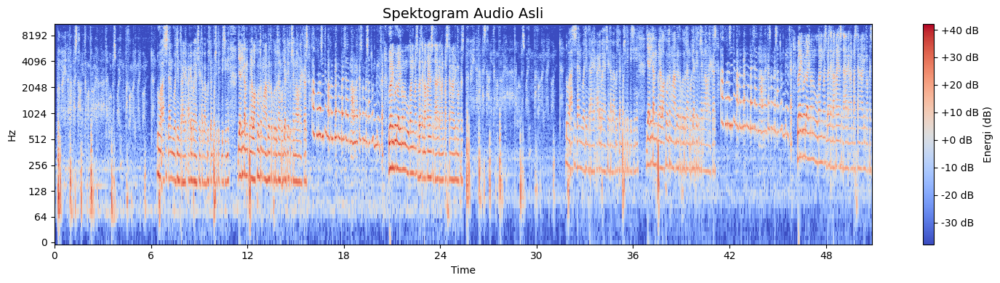

1. Equalizer (High-pass filter) diterapkan.


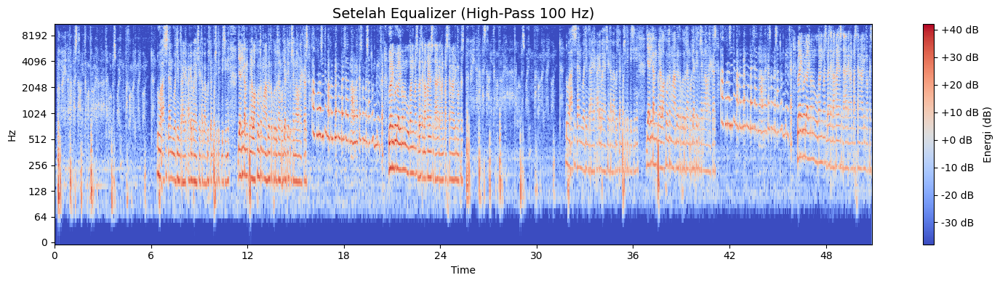

2. Normalisasi diterapkan.


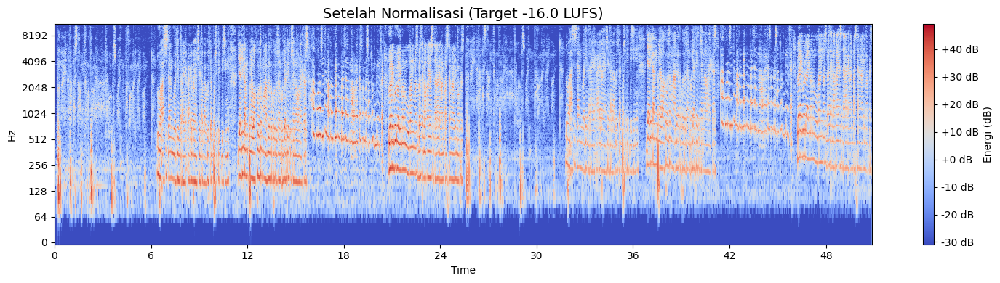

3. Fade In & Fade Out diterapkan.


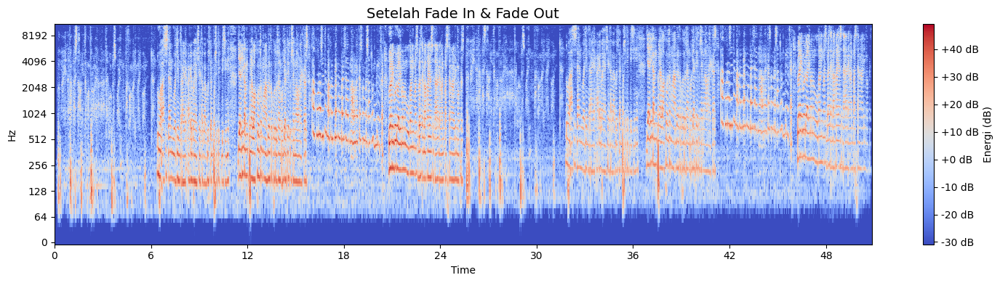

4. Kompresi dinamik diterapkan.


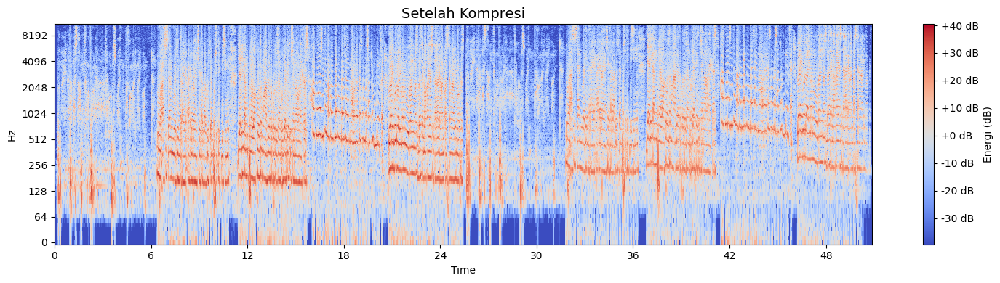

5 & 6. Noise Gate dan Silence Trimming diterapkan.


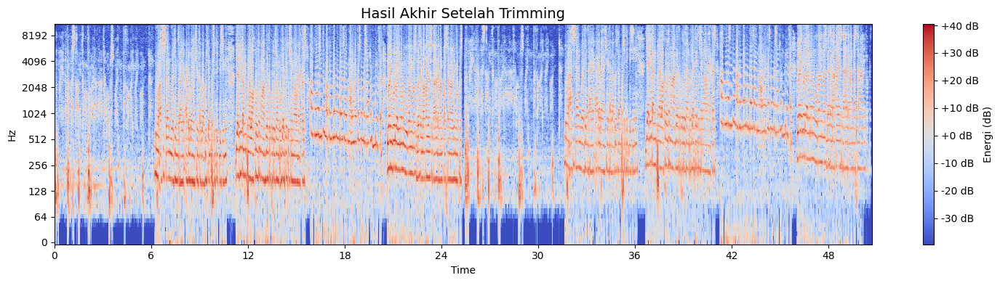


✅ Rantai pemrosesan audio selesai!

--- Audio Hasil Akhir ---


In [45]:
# --- Fungsi Pembantu untuk Plotting Spektogram ---
def plot_spectrogram(y, sr, title):
    """Fungsi untuk memvisualisasikan spektogram dari data audio."""
    fig, ax = plt.subplots(figsize=(15, 4))
    
    stft_data = librosa.stft(y)
    db_data = librosa.amplitude_to_db(abs(stft_data))
    
    img = librosa.display.specshow(db_data, sr=sr, x_axis='time', y_axis='log', ax=ax)
    
    fig.colorbar(img, ax=ax, format='%+2.0f dB', label='Energi (dB)')
    ax.set_title(title, fontsize=14)
    plt.tight_layout()
    plt.show()

# --- 1. Memuat file audio dengan librosa ---
combined_audio_path = 'audio/audio-3-combined.wav'
y_process, sr_process = librosa.load(combined_audio_path, sr=None)
print("--- Audio Asli Sebelum Diproses ---")
plot_spectrogram(y_process, sr_process, "Spektogram Audio Asli")

# --- 2. Menerapkan Rantai Pemrosesan ---

# --- Langkah 1: Equalizer (EQ) ---
from scipy.signal import butter, lfilter
b, a = butter(5, 100, btype='highpass', fs=sr_process)
y_eq = lfilter(b, a, y_process)
print("1. Equalizer (High-pass filter) diterapkan.")
plot_spectrogram(y_eq, sr_process, "Setelah Equalizer (High-Pass 100 Hz)")

# --- Langkah 2: Normalization (Target -16 LUFS) ---
meter = pyln.Meter(sr_process)
loudness = meter.integrated_loudness(y_eq)
target_lufs = -16.0
gain_db = target_lufs - loudness
gain_linear = 10 ** (gain_db / 20.0)
y_normalized = y_eq * gain_linear
print(f"2. Normalisasi diterapkan.")
plot_spectrogram(y_normalized, sr_process, f"Setelah Normalisasi (Target {target_lufs} LUFS)")

# --- Langkah 3: Gain/Fade ---
fade_duration_seconds = 1.0
fade_samples = int(fade_duration_seconds * sr_process)
fade_in_curve = np.linspace(0., 1., fade_samples)
fade_out_curve = np.linspace(1., 0., fade_samples)
# Buat salinan agar tidak memodifikasi array sebelumnya
y_faded = np.copy(y_normalized)
y_faded[:fade_samples] *= fade_in_curve
y_faded[-fade_samples:] *= fade_out_curve
print("3. Fade In & Fade Out diterapkan.")
# Visualisasi fade tidak akan terlihat jelas di spektogram, tapi tetap kita tampilkan
plot_spectrogram(y_faded, sr_process, "Setelah Fade In & Fade Out")

# --- Langkah 4: Compression ---
def simple_compressor(x, threshold_db=-20.0, ratio=4.0):
    threshold = 10**(threshold_db / 20.0)
    x_out = np.copy(x)
    mask = np.abs(x) > threshold
    compressed_values = threshold + ((np.abs(x[mask]) - threshold) / ratio)
    x_out[mask] = np.sign(x[mask]) * compressed_values
    return x_out
y_compressed = simple_compressor(y_faded)
print("4. Kompresi dinamik diterapkan.")
plot_spectrogram(y_compressed, sr_process, "Setelah Kompresi")

# --- Langkah 5 & 6: Noise Gate & Silence Trimming ---
intervals = librosa.effects.split(y_compressed, top_db=40)
y_trimmed_chunks = [y_compressed[start:end] for start, end in intervals]
y_final = np.concatenate(y_trimmed_chunks)
print("5 & 6. Noise Gate dan Silence Trimming diterapkan.")
plot_spectrogram(y_final, sr_process, "Hasil Akhir Setelah Trimming")

# --- Mengekspor dan Mendengarkan Hasil Akhir ---
import soundfile as sf
final_output_librosa_path = 'audio/audio-4-processed-librosa-compressed.wav'
sf.write(final_output_librosa_path, y_final, sr_process)

print(f"\n✅ Rantai pemrosesan audio selesai!")
print("\n--- Audio Hasil Akhir ---")
display(ipd.Audio(final_output_librosa_path))

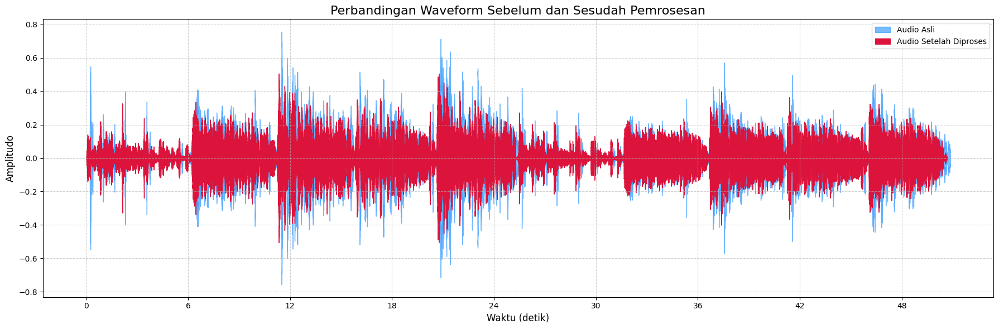

In [46]:
# --- 1. Pengaturan Tampilan Plot ---
fig, ax = plt.subplots(figsize=(18, 6))

# --- 2. Membuat Plot Waveform ---
# Plot waveform asli dengan warna biru dan transparansi
librosa.display.waveshow(y_process, sr=sr_process, ax=ax, color='dodgerblue', alpha=0.6, label='Audio Asli')

# Plot waveform yang sudah diproses di atasnya dengan warna merah
librosa.display.waveshow(y_final, sr=sr_process, ax=ax, color='crimson', label='Audio Setelah Diproses')


# --- 3. Menambahkan Judul, Label, dan Legenda ---
ax.set_title('Perbandingan Waveform Sebelum dan Sesudah Pemrosesan', fontsize=16)
ax.set_xlabel('Waktu (detik)', fontsize=12)
ax.set_ylabel('Amplitudo', fontsize=12)
ax.grid(True, linestyle='--', alpha=0.6)
ax.legend() # Menampilkan legenda untuk membedakan warna


# --- 4. Menampilkan Plot ---
plt.tight_layout()
plt.show()

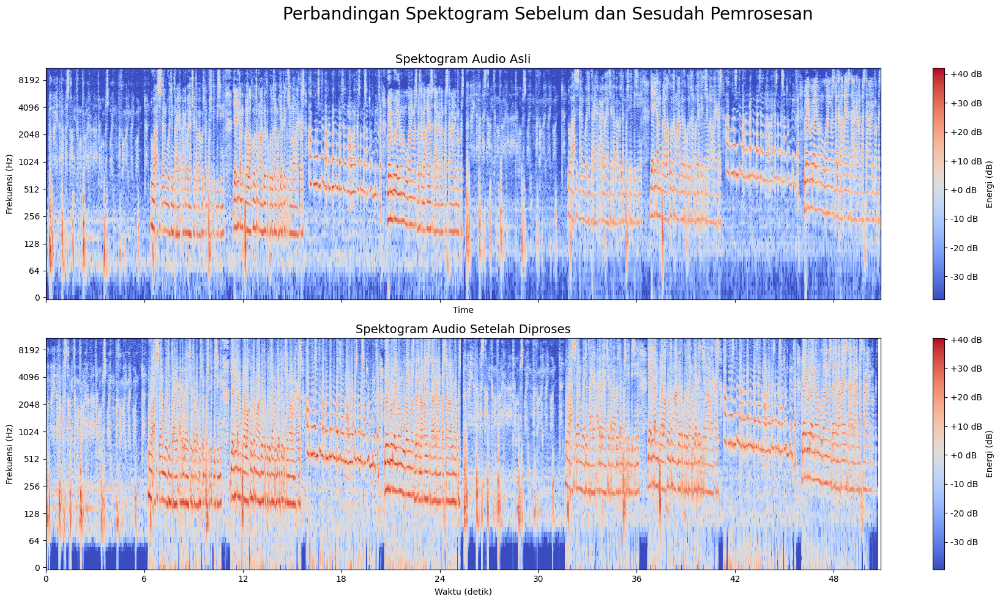

In [47]:
# --- 1. Membuat Grid Plot 2x1 ---
# nrows=2, ncols=1 untuk 2 baris, 1 kolom
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(18, 10), sharex=True)


# --- 2. Plot Spektogram Asli (Atas) ---
stft_asli = librosa.stft(y_process)
db_asli = librosa.amplitude_to_db(abs(stft_asli))
img1 = librosa.display.specshow(db_asli, sr=sr_process, x_axis='time', y_axis='log', ax=ax[0])
ax[0].set_title('Spektogram Audio Asli', fontsize=14)
ax[0].set_ylabel('Frekuensi (Hz)')


# --- 3. Plot Spektogram Hasil Proses (Bawah) ---
stft_final = librosa.stft(y_final)
db_final = librosa.amplitude_to_db(abs(stft_final))
img2 = librosa.display.specshow(db_final, sr=sr_process, x_axis='time', y_axis='log', ax=ax[1])
ax[1].set_title('Spektogram Audio Setelah Diproses', fontsize=14)
ax[1].set_xlabel('Waktu (detik)')
ax[1].set_ylabel('Frekuensi (Hz)')


# --- 4. Menambahkan Detail Akhir dan Menampilkan ---
# Membuat colorbar di samping plot
fig.colorbar(img1, ax=ax[0], format='%+2.0f dB', label='Energi (dB)')
fig.colorbar(img2, ax=ax[1], format='%+2.0f dB', label='Energi (dB)')

# Memberikan judul utama
fig.suptitle('Perbandingan Spektogram Sebelum dan Sesudah Pemrosesan', fontsize=20)

plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

**Penjelasan**:
- Perubahan dinamika suara yang terjadi => Setelah dilakukannya Equalizer frekuensi rendah di Bawah 100 Hz mulai berkurang atau menghilang. Setelah dilakukan Normalisasi warna spektogram menjadi lebih terang. Setelah dilakukan Fade In & Fade Out energi suara di 5 detik awal sedikit lemah. Setelah dilakukannya Kompresi warna spektogram menjadi lebih merata atau sama. Setelah dilakukannya Noise Gate & Silence Trimming, bagian yang hening menjadi hilang dan durasi berkurang.

- Perbedaan antara normalisasi peak dan normalisasi LUFS => Normalisasi Peak mengubah volume audio ke satu titik yang paling keras atau level tertinggi, Normalisasi LUFS mengatur volume agar bisa didengar oleh manusia.

- Kualitas suara berubah setelah proses normalisasi dan loudness
optimization => Kualitas suara berubah menjadi lebih konsisten dan jelas.

- Kelebihan dan kekurangan dari pengoptimalan loudness dalam konteks rekaman suara => Kelebihannya adalah menciptakan kualitas suara yang konsisten dan jelas. Kekurangannya adalah bisa berpotensi memperkuat suara noise juga dan bisa membuat audio terdengar datar.

---

#### **5. Soal 5: Music Analysis dan Remix**  

In [48]:
# --- 1. Memuat Dua File Lagu ---
try:
    y_song1, sr_song1 = librosa.load('audio/lagu-1.wav', sr=None)
    y_song2, sr_song2 = librosa.load('audio/lagu-2.wav', sr=None)
    print("Berhasil memuat kedua file lagu.")
except Exception as e:
    print(f"Gagal memuat file lagu: {e}")

# --- 2. Analisis Lagu 1 (Sedih, Lambat) ---
print("\n--- Analisis Lagu 1 (Sedih, Lambat) ---")

# Deteksi Tempo (BPM)
tempo1, _ = librosa.beat.beat_track(y=y_song1, sr=sr_song1)
# DIPERBAIKI: Ambil elemen pertama dari array tempo
print(f"🎵 Estimasi Tempo (BPM): {tempo1[0]:.2f}")

# Estimasi Kunci (Key)
chroma1 = librosa.feature.chroma_stft(y=y_song1, sr=sr_song1)
chroma_mean1 = np.mean(chroma1, axis=1)
key_index1 = np.argmax(chroma_mean1)
notes = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
estimated_key1 = notes[key_index1]
print(f"🎼 Estimasi Kunci (Key): {estimated_key1}")

# --- 3. Analisis Lagu 2 (Ceria, Cepat) ---
print("\n--- Analisis Lagu 2 (Ceria, Cepat) ---")

# Deteksi Tempo (BPM)
tempo2, _ = librosa.beat.beat_track(y=y_song2, sr=sr_song2)
# DIPERBAIKI: Ambil elemen pertama dari array tempo
print(f"🎵 Estimasi Tempo (BPM): {tempo2[0]:.2f}")

# Estimasi Kunci (Key)
chroma2 = librosa.feature.chroma_stft(y=y_song2, sr=sr_song2)
chroma_mean2 = np.mean(chroma2, axis=1)
key_index2 = np.argmax(chroma_mean2)
estimated_key2 = notes[key_index2]
print(f"🎼 Estimasi Kunci (Key): {estimated_key2}")

Berhasil memuat kedua file lagu.

--- Analisis Lagu 1 (Sedih, Lambat) ---
🎵 Estimasi Tempo (BPM): 98.68
🎼 Estimasi Kunci (Key): A

--- Analisis Lagu 2 (Ceria, Cepat) ---
🎵 Estimasi Tempo (BPM): 181.45
🎼 Estimasi Kunci (Key): E


**Analisis Singkat**  
- Lagu 1 memiliki tempo 98.68 BPM, yang termasuk tempo sedang-lambat (andante), sangat cocok untuk lagu bernuansa sedih atau balada. Kunci dasarnya adalah A, yang bisa berupa A mayor atau A minor, di mana A minor sering digunakan untuk menciptakan nuansa melankolis.
- Lagu 2 memiliki tempo yang hampir dua kali lipat lebih cepat, yaitu 181.45 BPM. Tempo yang sangat cepat ini secara langsung menciptakan nuansa yang energik dan ceria. Kunci dasarnya adalah E, yang kemungkinan besar adalah E Mayor, sebuah kunci yang umum digunakan dalam musik yang bersemangat dan positif.

In [49]:
# --- 1. Menentukan Target Tempo dan Kunci ---
target_tempo = tempo2[0]
print(f"Tempo target diatur ke: {target_tempo:.2f} BPM (dari Lagu 2)")

target_key_index = key_index2
semitone_shift = -5
print(f"Kunci target diatur ke: '{estimated_key2}'. Lagu 1 (A) akan di-pitch shift sebanyak {semitone_shift} semitone.")

# --- 2. Time Stretch Lagu 1 (Lambat) ---
stretch_ratio = target_tempo / tempo1[0]
y_song1_stretched = librosa.effects.time_stretch(y=y_song1, rate=stretch_ratio)
print("\n1. Time-stretch pada Lagu 1 selesai.")

# --- 3. Pitch Shift Lagu 1 (yang sudah di-stretch) ---
y_song1_final = librosa.effects.pitch_shift(y=y_song1_stretched, sr=sr_song1, n_steps=semitone_shift)
print("2. Pitch-shift pada Lagu 1 selesai.")

# --- 4. Crossfading Menggunakan Pydub ---
# Potong durasi kedua lagu agar sama panjang
min_duration_ms = int(min(len(y_song1_final) * 1000 / sr_song1, len(y_song2) * 1000 / sr_song2))

# Konversi Lagu 1 yang sudah diproses
samples_1 = (y_song1_final * 32767).astype(np.int16)
song1_segment = AudioSegment(samples_1.tobytes(), frame_rate=sr_song1, sample_width=2, channels=1)[:min_duration_ms]

# Konversi Lagu 2 (asli)
samples_2 = (y_song2 * 32767).astype(np.int16)
song2_segment = AudioSegment(samples_2.tobytes(), frame_rate=sr_song2, sample_width=2, channels=1)[:min_duration_ms]

# --- BAGIAN YANG DIPERBAIKI ---
print("3. Menerapkan Crossfade...")
# Buat versi fade-out dari lagu pertama sepanjang durasi total
song1_faded = song1_segment.fade_out(duration=min_duration_ms)

# Buat versi fade-in dari lagu kedua sepanjang durasi total
song2_faded = song2_segment.fade_in(duration=min_duration_ms)

# Timpa (overlay) lagu yang sudah di-fade-in di atas lagu yang sudah di-fade-out
remix = song1_faded.overlay(song2_faded)
print("   Crossfade kedua lagu selesai.")
# --- AKHIR BAGIAN YANG DIPERBAIKI ---


# --- 5. (Opsional) Filter Tambahan ---
remix = remix.low_pass_filter(3000)
print("4. Filter tambahan (low-pass) diterapkan.")

# --- 6. Ekspor Hasil Remix ---
remix_output_path = 'audio/audio-5-remix.wav'
remix.export(remix_output_path, format='wav')

print(f"\n✅ Remix selesai! File disimpan di: {remix_output_path}")
display(ipd.Audio(remix_output_path))

Tempo target diatur ke: 181.45 BPM (dari Lagu 2)
Kunci target diatur ke: 'E'. Lagu 1 (A) akan di-pitch shift sebanyak -5 semitone.

1. Time-stretch pada Lagu 1 selesai.
2. Pitch-shift pada Lagu 1 selesai.
3. Menerapkan Crossfade...
   Crossfade kedua lagu selesai.
4. Filter tambahan (low-pass) diterapkan.

✅ Remix selesai! File disimpan di: audio/audio-5-remix.wav


**Penjelasan**:  
Proses remix ini dimulai dengan menyamakan tempo Lagu 1 (98.68 BPM) ke tempo target Lagu 2 (181.45 BPM) menggunakan time-stretch. Selanjutnya, kunci (key) Lagu 1 diubah dari 'A' menjadi 'E' dengan menurunkannya sebanyak -5 semitone agar serasi dengan Lagu 2. Setelah kedua lagu selaras, keduanya dipotong agar memiliki durasi yang sama dan digabungkan menggunakan efek crossfade dengan durasi transisi selama 5000 milidetik (5 detik), di mana volume Lagu 1 perlahan menurun sementara volume Lagu 2 perlahan meningkat. Sebagai sentuhan akhir, sebuah filter low-pass dengan cutoff 3000 Hz ditambahkan untuk memberikan karakter suara yang sedikit lebih lembut pada hasil akhir.

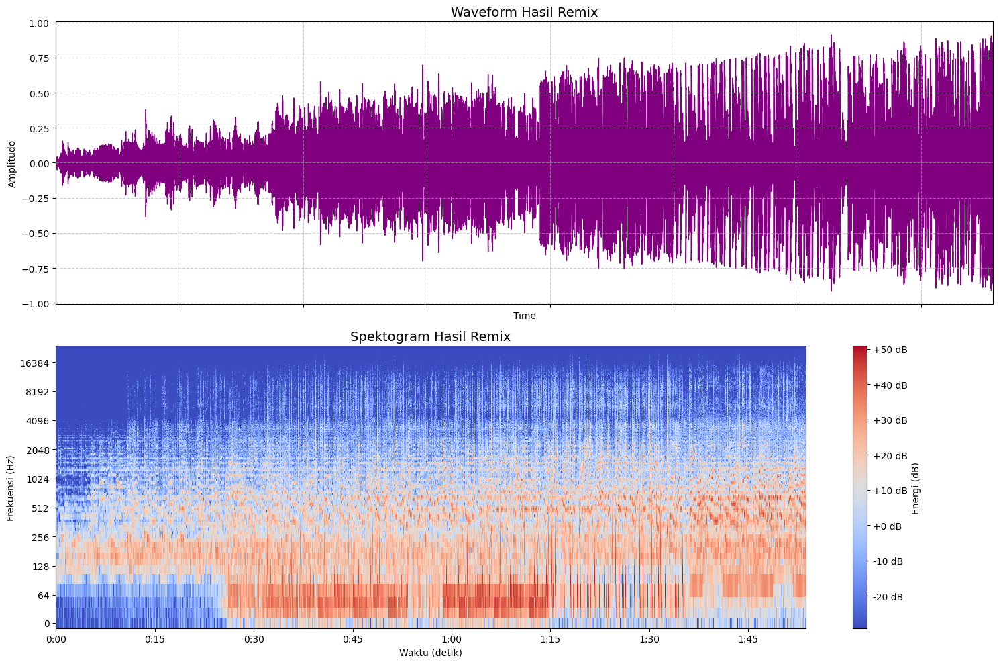

In [50]:
# --- 1. Memuat File Audio Remix ---
# Memuat file hasil remix untuk dianalisis dan divisualisasikan.
y_remix, sr_remix = librosa.load('audio/audio-5-remix.wav', sr=None)


# --- 2. Membuat Grid Plot 2x1 ---
# Membuat 2 plot (waveform dan spektogram) yang disusun secara vertikal.
fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(15, 10), sharex=True)


# --- 3. Plot Waveform (Atas) ---
librosa.display.waveshow(y_remix, sr=sr_remix, ax=ax[0], color='purple')
ax[0].set_title('Waveform Hasil Remix', fontsize=14)
ax[0].set_ylabel('Amplitudo')
ax[0].grid(True, linestyle='--', alpha=0.6)


# --- 4. Plot Spektogram (Bawah) ---
stft_remix = librosa.stft(y_remix)
db_remix = librosa.amplitude_to_db(abs(stft_remix))
img = librosa.display.specshow(db_remix, sr=sr_remix, x_axis='time', y_axis='log', ax=ax[1])
ax[1].set_title('Spektogram Hasil Remix', fontsize=14)
ax[1].set_xlabel('Waktu (detik)')
ax[1].set_ylabel('Frekuensi (Hz)')

# Menambahkan colorbar untuk spektogram
fig.colorbar(img, ax=ax[1], format='%+2.0f dB', label='Energi (dB)')


# --- 5. Menampilkan Plot ---
plt.tight_layout()
plt.show()

**Penjelasan**:  
Berdasarkan visualisasi yang diberikan, hasil remix menunjukkan transisi yang mulus dan efektif antara kedua lagu. Waveform di bagian atas secara jelas menampilkan efek crossfade, di mana amplitudo (volume) secara bertahap meningkat dari awal hingga akhir, menandakan pergerakan dari lagu yang lebih tenang ke lagu yang lebih energik. Hal ini didukung oleh spektogram di bagian bawah, yang memperlihatkan energi musikal (warna oranye/merah) pada awalnya terkonsentrasi di frekuensi yang lebih rendah dan sederhana, kemudian secara bertahap bertransisi menjadi lebih kompleks dan tersebar di spektrum frekuensi yang lebih luas, yang merupakan karakteristik dari lagu kedua yang lebih cepat dan ceria.

---

### **Credit dan Referensi**
Gemini: https://gemini.google.com/share/92e443e5fadf